In [1]:
import numpy as np
import pandas as pd
import json
import cv2
import os
from scipy.spatial import Delaunay, ConvexHull
import matplotlib.pyplot as plt

from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo

from detectron2.data.datasets import register_coco_instances
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Data

In [2]:
with open('data/annotations/dataset.json', 'r') as f:
    coco_data = json.load(f)

coco_data['categories']

[{'id': 1, 'name': 'intersection', 'supercategory': 'intersection'},
 {'id': 2, 'name': 'crosswalk', 'supercategory': 'crosswalk'},
 {'id': 4, 'name': 'overhead', 'supercategory': 'overhead'},
 {'id': 5, 'name': 'median', 'supercategory': 'median'},
 {'id': 6, 'name': 'doubleYellow', 'supercategory': 'doubleYellow'},
 {'id': 7, 'name': 'bikeLane', 'supercategory': 'bikeLane'},
 {'id': 8, 'name': 'overpass', 'supercategory': 'overpass'},
 {'id': 10, 'name': 'busLane', 'supercategory': 'busLane'}]

In [3]:
class_labels = [x['name'] for x in coco_data['categories']]
class_labels

['intersection',
 'crosswalk',
 'overhead',
 'median',
 'doubleYellow',
 'bikeLane',
 'overpass',
 'busLane']

In [4]:
len(class_labels)

8

# Helper Functions

In [5]:
# Load Detectron2 model configuration and weights
def setup_predictor():
    cfg = get_cfg()
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(coco_data['categories'])
    cfg.MODEL.WEIGHTS = 'models/model_final.pth' # "detectron2/output/model_final.pth" # os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Adjust threshold as needed
    cfg.MODEL.DEVICE = "cuda"  # Use GPU if available
    return DefaultPredictor(cfg)

In [6]:
predictor = setup_predictor()

In [7]:
def fit_polygon_delaunay(contour):
    """
    Fit a polygon using Delaunay triangulation.

    Parameters:
        contour (numpy.ndarray): Contour points as a 2D array (N, 2).

    Returns:
        numpy.ndarray: Array of vertices of the fitted polygon.
    """
    # Ensure contour is 2D
    if contour.ndim != 2 or contour.shape[1] != 2:
        raise ValueError("Contour must be a 2D array with shape (N, 2).")

    # Delaunay triangulation
    tri = Delaunay(contour)

    # Extract the convex hull (outermost polygon)
    hull_indices = cv2.convexHull(contour, returnPoints=False).flatten()
    hull_points = contour[hull_indices]

    return hull_points

In [8]:
def measure_crosswalk_dimensions(polygon):
    """
    Measure the length and width of a crosswalk from a polygon.

    Parameters:
        polygon (numpy.ndarray): Nx2 array of polygon vertices.

    Returns:
        tuple: (length, width)
            length (float): Longest distance between two vertices (distance pedestrians walk).
            width (float): Shortest distance across the polygon (space available for pedestrians).
    """
    # Step 1: Simplify the polygon using a convex hull
    hull = ConvexHull(polygon)
    hull_points = polygon[hull.vertices]

    # Step 2: Calculate all pairwise distances between hull points
    num_points = len(hull_points)
    pairwise_distances = []
    for i in range(num_points):
        for j in range(i + 1, num_points):
            dist = np.linalg.norm(hull_points[i] - hull_points[j])
            pairwise_distances.append((dist, i, j))

    # Step 3: Identify the longest distance (length)
    pairwise_distances = sorted(pairwise_distances, key=lambda x: -x[0])  # Sort by descending distance
    length, idx1, idx2 = pairwise_distances[0]  # Longest distance and its endpoints
    longest_axis = (hull_points[idx1], hull_points[idx2])

    # Step 4: Calculate perpendicular distances to the longest axis (width)
    def point_to_line_distance(point, line_start, line_end):
        line_vec = line_end - line_start
        point_vec = point - line_start
        line_len = np.linalg.norm(line_vec)
        if line_len == 0:
            return np.linalg.norm(point_vec)
        projection = np.dot(point_vec, line_vec) / line_len
        proj_point = line_start + projection * (line_vec / line_len)
        return np.linalg.norm(point - proj_point)

    # Measure perpendicular distances from all hull points to the longest axis
    line_start, line_end = longest_axis
    perpendicular_distances = [
        point_to_line_distance(pt, line_start, line_end) for pt in hull_points if not np.array_equal(pt, line_start) and not np.array_equal(pt, line_end)
    ]
    width = max(perpendicular_distances) if perpendicular_distances else 0  # Take the largest perpendicular distance as width

    return length, width

In [9]:
def measure_intersection_sides(polygon):
    """
    Measure the lengths of the four sides of an intersection polygon by approximating it
    to a quadrilateral, with improved robustness.

    Parameters:
        polygon (numpy.ndarray): Nx2 array of vertices representing the polygon.

    Returns:
        tuple: (results, quad_points)
            results: Dictionary mapping directions to side lengths:
                     {"north": length, "south": length, "east": length, "west": length}.
            quad_points: Nx2 array of quadrilateral vertices.
    """
    # Ensure the polygon is in the correct format for OpenCV functions
    if polygon.ndim == 2:
        contour = polygon.reshape(-1, 1, 2).astype(np.int32)  # Convert to (N, 1, 2)
    else:
        contour = polygon.astype(np.int32)

    # Attempt to approximate the contour to a quadrilateral
    peri = cv2.arcLength(contour, True)
    approx = None

    # Try multiple epsilon values to find an approximation with 4 points
    for epsilon_factor in np.linspace(0.01, 0.1, 20):
        epsilon = epsilon_factor * peri
        approx_candidate = cv2.approxPolyDP(contour, epsilon, True)
        if len(approx_candidate) == 4:
            approx = approx_candidate
            break  # Exit the loop if we find a suitable approximation

    if approx is None:
        # If we cannot approximate to a quadrilateral, use minAreaRect as a fallback
        rect = cv2.minAreaRect(contour)
        box = cv2.boxPoints(rect)
        quad_points = np.int0(box)
    else:
        # Extract the points of the quadrilateral
        quad_points = approx[:, 0, :]  # Shape (4, 2)

    # Compute centroid of the quadrilateral
    centroid = np.mean(quad_points, axis=0)

    # Initialize directions
    directions = {"north": [], "south": [], "east": [], "west": []}

    # Iterate over each side of the quadrilateral
    for i in range(4):
        pt1 = quad_points[i]
        pt2 = quad_points[(i + 1) % 4]
        length = np.linalg.norm(pt2 - pt1)

        # Compute midpoint of the side
        midpoint = (pt1 + pt2) / 2
        delta = midpoint - centroid
        angle = np.arctan2(delta[1], delta[0])  # Angle in radians

        # Assign side to a direction based on its angle
        angle_deg = np.degrees(angle) % 360  # Convert angle to degrees and normalize
        if 45 <= angle_deg < 135:  # North
            directions["south"].append({"length": length, "points": (tuple(pt1), tuple(pt2))})
        elif 135 <= angle_deg < 225:  # West
            directions["west"].append({"length": length, "points": (tuple(pt1), tuple(pt2))})
        elif 225 <= angle_deg < 315:  # South
            directions["north"].append({"length": length, "points": (tuple(pt1), tuple(pt2))})
        else:  # East
            directions["east"].append({"length": length, "points": (tuple(pt1), tuple(pt2))})

    # Summarize results by selecting the side with maximum length for each direction
    results = {}
    for dir, sides in directions.items():
        if sides:
            # Choose the side with maximum length
            max_side = max(sides, key=lambda x: x["length"])
            results[dir] = max_side
        else:
            # If no side was assigned to this direction
            results[dir] = {"length": None, "points": None}

    return results, quad_points

In [10]:
def visualize_model_predictions(predictor, img_file_path, metadata, plot=True):
    img = cv2.imread(img_file_path)
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    if plot:
        plt.figure(figsize=(15, 10))
        plt.imshow(v.get_image())
        plt.axis("off")
        plt.show()
    else:
        return v.get_image()

annotation_file = "data/annotations/dataset.json"
image_path = "data/images/"
register_coco_instances("clean_train", {}, annotation_file, image_path)

# Verify dataset registration
metadata = MetadataCatalog.get("clean_train")
dataset_dicts = DatasetCatalog.get("clean_train")


Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



In [11]:
def visualize_crosswalk_measurements(predictor, img_file_path, metadata, class_labels, fit_function, plot=True):
    """
    Visualize crosswalk measurements (length and width) based on the fitted polygon.

    Parameters:
        predictor: Detectron2 predictor object.
        img_file_path (str): Path to the image file.
        metadata: Metadata object for the visualizer.
        class_labels: List of class labels corresponding to class indices.
        fit_function: Polygon fitting function (e.g., fit_polygon_delaunay).
    """

    # Read the image
    img = cv2.imread(img_file_path)
    outputs = predictor(img)

    # Initialize the visualizer
    from detectron2.utils.visualizer import Visualizer
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Extract predictions
    instances = outputs["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()

    # Overlay length and width measurements
    for i, cls in enumerate(classes):
        if class_labels[cls] == "crosswalk":
            mask = masks[i].astype(np.uint8)
            
            # Find contours
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if not contours:
                continue  # Skip if no contours are found
            
            # Use the largest contour
            contour = max(contours, key=cv2.contourArea)

            # Ensure contour is a 2D array of (x, y) points
            if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)

            # Fit polygon using the provided fitting function
            vertices = fit_function(contour)

            # Measure dimensions
            length, width = measure_crosswalk_dimensions(vertices)

            # Draw the fitted polygon on the image
            for j in range(len(vertices)):
                pt1 = tuple(vertices[j])
                pt2 = tuple(vertices[(j + 1) % len(vertices)])  # Wrap around to the first vertex
                cv2.line(img, pt1, pt2, (0, 255, 0), 2)  # Green lines for polygons

            # Annotate measurements
            midpoint = tuple(np.mean(vertices, axis=0).astype(int))  # Find the polygon's center
            cv2.putText(img, f"Length: {length:.2f}", (midpoint[0] - 50, midpoint[1] - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
            cv2.putText(img, f"Width: {width:.2f}", (midpoint[0] - 50, midpoint[1] + 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    if plot:
        # Show the results
        plt.figure(figsize=(15, 10))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()
    else:
        return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

c:\Users\Keith\miniconda3\envs\intersections\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at C:\cb\pytorch_1000000000000\work\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


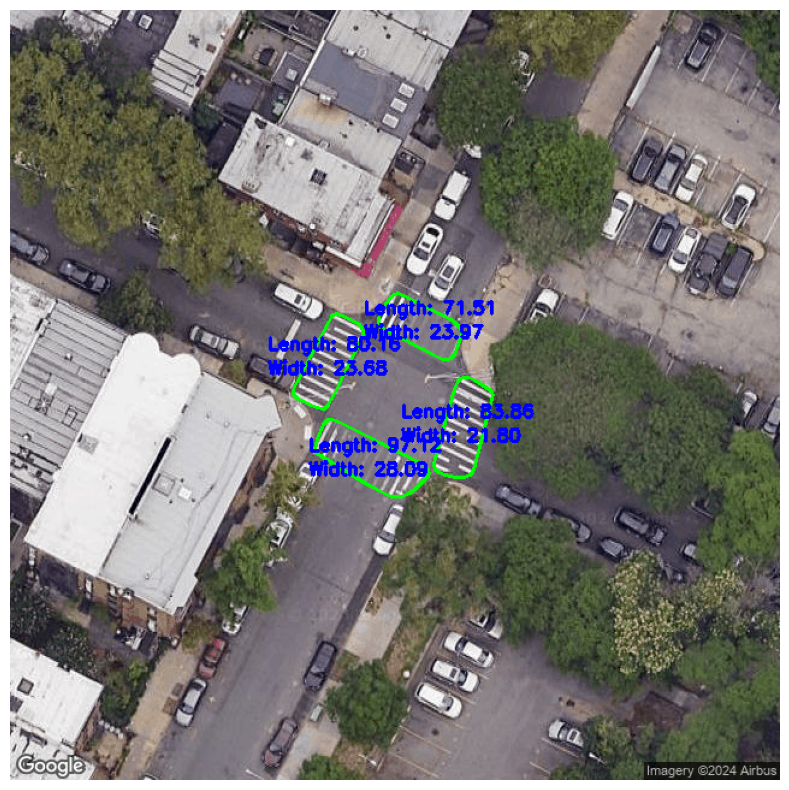

In [12]:
img_file_path = 'data/images/40.68355_-73.98438.png'
visualize_crosswalk_measurements(predictor, img_file_path, metadata, class_labels, fit_polygon_delaunay)

In [13]:
def visualize_intersection_sides(predictor, img_file_path, metadata, class_labels, fit_function, plot=True):
    """
    Visualize the four sides of an intersection polygon, assigning lengths and cardinal directions.

    Parameters:
        predictor: Detectron2 predictor object.
        img_file_path (str): Path to the image file.
        metadata: Metadata object for visualizer.
        class_labels: List of class labels corresponding to class indices.
        plot (bool): Whether to display the plot. If False, returns the image array.
    """

    # Read the image
    img = cv2.imread(img_file_path)
    outputs = predictor(img)

    # Initialize the visualizer
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Extract predictions
    instances = outputs["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()

    # Process intersection polygons
    for i, cls in enumerate(classes):
        if class_labels[cls] == "intersection":
            mask = masks[i].astype(np.uint8)

            # Find contours
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if not contours:
                continue  # Skip if no contours are found

            # Use the largest contour
            contour = max(contours, key=cv2.contourArea)

            # Ensure contour is a 2D array of (x, y) points
            if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)

            # Fit polygon using the provided fitting function
            polygon = fit_function(contour)

            # Measure sides and assign directions
            try:
                side_lengths, quad_points = measure_intersection_sides(contour)
            except ValueError as e:
                print(f"Warning: {e}")
                continue  # Skip this intersection if approximation fails

            # Draw the quadrilateral
            for j in range(len(quad_points)):
                pt1 = tuple(quad_points[j])
                pt2 = tuple(quad_points[(j + 1) % len(quad_points)])  # Wrap around
                cv2.line(img, pt1, pt2, (0, 255, 0), 2)  # Green polygon edges

            # Annotate directions and lengths
            for direction, info in side_lengths.items():
                if info["points"] is not None and info["length"] is not None:
                    pt1, pt2 = info["points"]
                    midpoint = tuple(((np.array(pt1) + np.array(pt2)) / 2).astype(int))
                    cv2.putText(img, f"{direction}: {info['length']:.2f}",
                                midpoint, cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)
        else:
            # For other classes, you can handle visualization as needed
            pass

    if plot:
        # Show the results
        plt.figure(figsize=(15, 10))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()
    else:
        return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

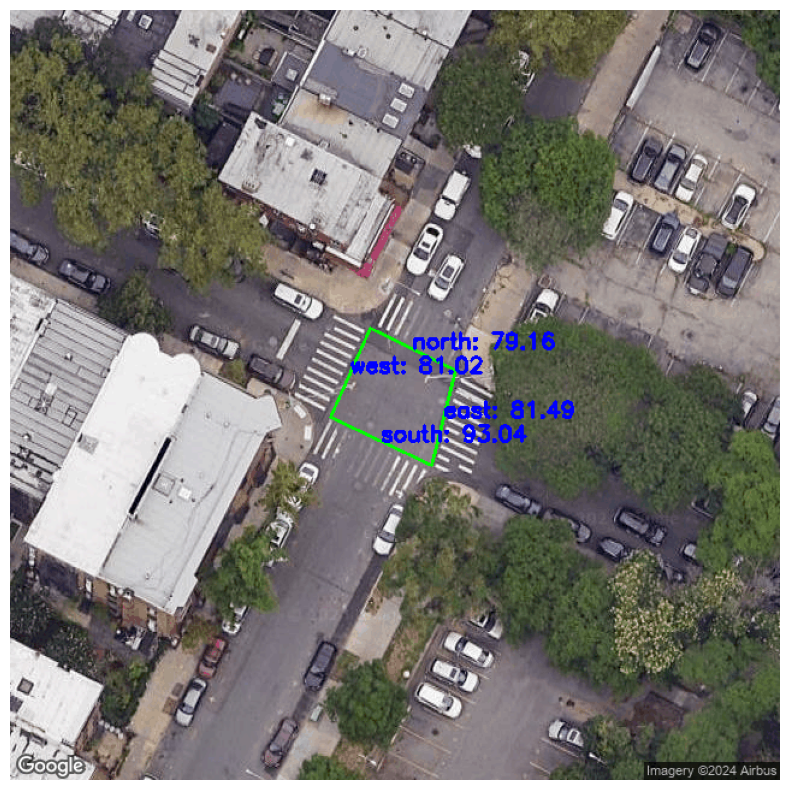

In [14]:
img_file_path = 'data/images/40.68355_-73.98438.png'
visualize_intersection_sides(predictor, img_file_path, metadata, class_labels, fit_polygon_delaunay)

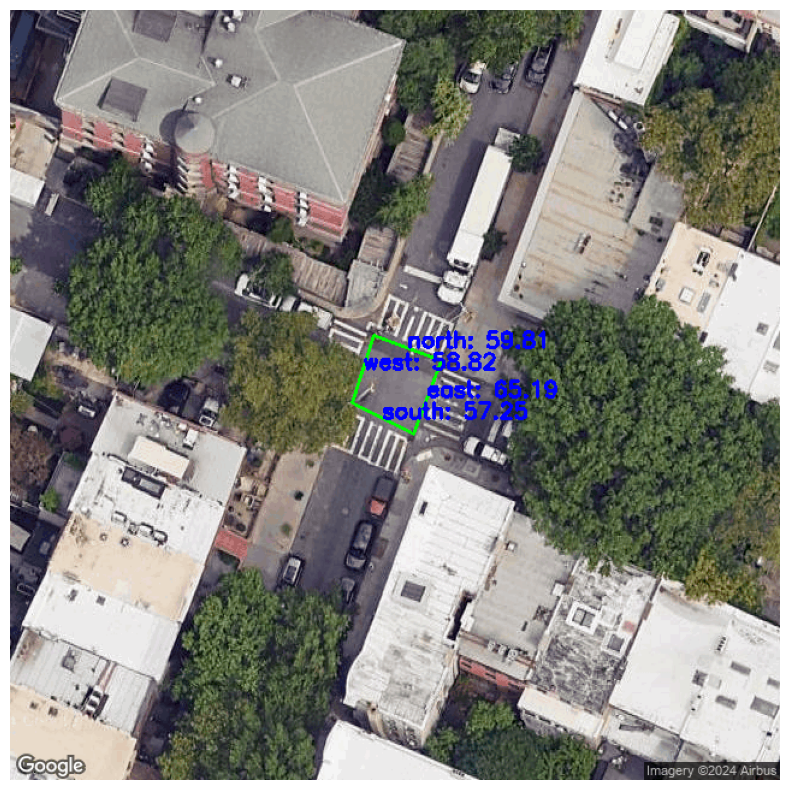

In [15]:
img_file_path = 'data/images/40.688_-73.997562.png'
visualize_intersection_sides(predictor, img_file_path, metadata, class_labels, fit_polygon_delaunay)

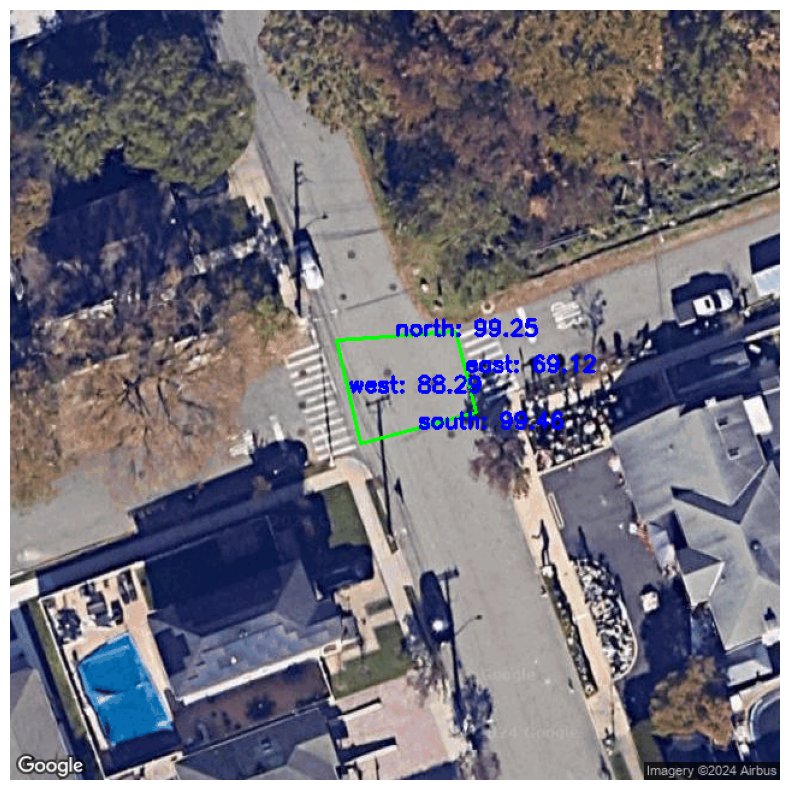

In [16]:
img_file_path = 'data/images/40.542_-74.187925.png'
visualize_intersection_sides(predictor, img_file_path, metadata, class_labels, fit_polygon_delaunay)

In [17]:
def assign_crosswalks_to_directions(intersection_polygon, crosswalk_polygons):
    """
    Assign each crosswalk to a cardinal direction relative to the intersection.

    Parameters:
        intersection_polygon (numpy.ndarray): Nx2 array of vertices for the intersection polygon.
        crosswalk_polygons (list of numpy.ndarray): List of Nx2 arrays representing crosswalk polygons.

    Returns:
        dict: Dictionary mapping directions to crosswalk polygons:
              {"north": [polygon1, polygon2, ...], "south": [...], "east": [...], "west": [...]}.
    """
    # Step 1: Compute the centroid of the intersection
    intersection_centroid = np.mean(intersection_polygon, axis=0)

    # Step 2: Initialize direction mapping
    direction_mapping = {"north": [], "south": [], "east": [], "west": []}

    # Step 3: Assign each crosswalk to a direction
    for crosswalk_polygon in crosswalk_polygons:
        # Compute the centroid of the crosswalk
        crosswalk_centroid = np.mean(crosswalk_polygon, axis=0)

        # Calculate the angle of the crosswalk centroid relative to the intersection centroid
        angle = np.arctan2(crosswalk_centroid[1] - intersection_centroid[1],
                           crosswalk_centroid[0] - intersection_centroid[0])

        # Assign direction based on the angle
        if -np.pi / 4 <= angle < np.pi / 4:  # East
            direction_mapping["east"].append(crosswalk_polygon)
        elif -3 * np.pi / 4 <= angle < -np.pi / 4:  # North
            direction_mapping["north"].append(crosswalk_polygon)
        elif np.pi / 4 <= angle < 3 * np.pi / 4:  # South
            direction_mapping["south"].append(crosswalk_polygon)
        else:  # West
            direction_mapping["west"].append(crosswalk_polygon)

    return direction_mapping

In [18]:
def visualize_crosswalk_directions(predictor, img_file_path, metadata, class_labels, fit_function, plot=True):
    """
    Visualize crosswalk polygons and their assigned directions relative to an intersection.

    Parameters:
        predictor: Detectron2 predictor object.
        img_file_path (str): Path to the image file.
        metadata: Metadata object for visualizer.
        class_labels: List of class labels corresponding to class indices.
        fit_function: Polygon fitting function (e.g., fit_polygon_delaunay).
    """

    # Read the image
    img = cv2.imread(img_file_path)
    outputs = predictor(img)

    # Initialize the visualizer
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Extract predictions
    instances = outputs["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()

    # Identify intersection and crosswalks
    intersection_polygon = None
    crosswalk_polygons = []
    for i, cls in enumerate(classes):
        mask = masks[i].astype(np.uint8)
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        if not contours:
            continue  # Skip if no contours are found

        contour = max(contours, key=cv2.contourArea)  # Use the largest contour
        if contour.ndim == 3:
            contour = contour[:, 0, :]  # Convert to 2D array

        if class_labels[cls] == "intersection":
            intersection_polygon = fit_function(contour)
        elif class_labels[cls] == "crosswalk":
            crosswalk_polygons.append(fit_function(contour))

    # Assign crosswalks to directions
    if intersection_polygon is None:
        print("No intersection found.")
        return

    direction_mapping = assign_crosswalks_to_directions(intersection_polygon, crosswalk_polygons)

    # Visualize intersection polygon
    for i in range(len(intersection_polygon)):
        pt1 = tuple(intersection_polygon[i])
        pt2 = tuple(intersection_polygon[(i + 1) % len(intersection_polygon)])  # Wrap around
        cv2.line(img, pt1, pt2, (0, 255, 0), 2)  # Green for intersection polygon

    # Visualize crosswalks and annotate directions
    for direction, polygons in direction_mapping.items():
        for polygon in polygons:
            for j in range(len(polygon)):
                pt1 = tuple(polygon[j])
                pt2 = tuple(polygon[(j + 1) % len(polygon)])
                cv2.line(img, pt1, pt2, (255, 0, 0), 2)  # Blue for crosswalks

            # Annotate direction at the centroid
            centroid = tuple(np.mean(polygon, axis=0).astype(int))
            cv2.putText(img, direction, centroid, cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 0), 2)

    if plot:
        # Show the results
        plt.figure(figsize=(15, 10))
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis("off")
        plt.show()
    else:
        return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

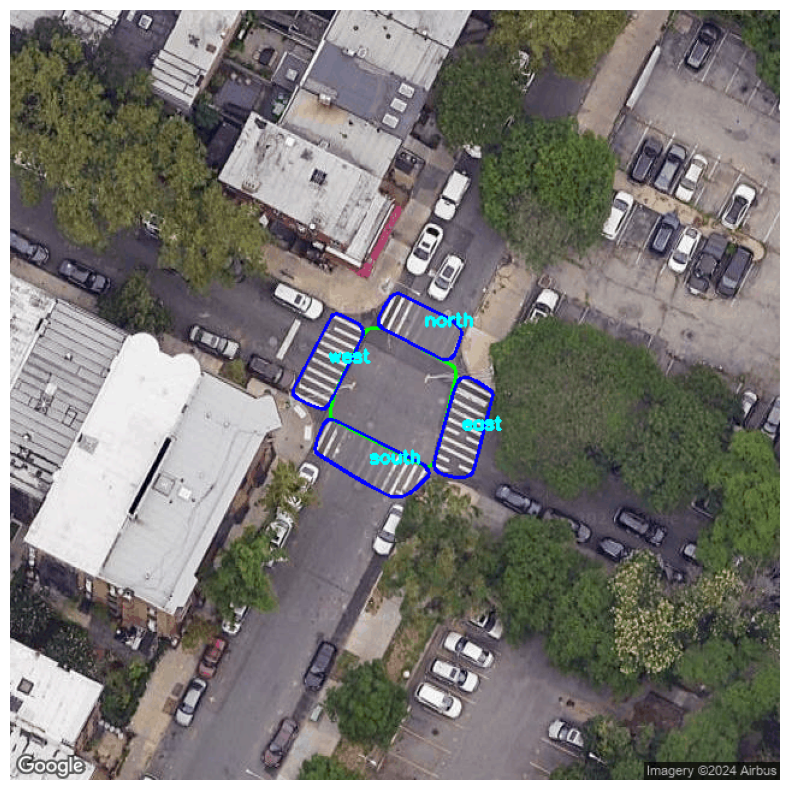

In [19]:
img_file_path = 'data/images/40.68355_-73.98438.png'
visualize_crosswalk_directions(predictor, img_file_path, metadata, class_labels, fit_polygon_delaunay)

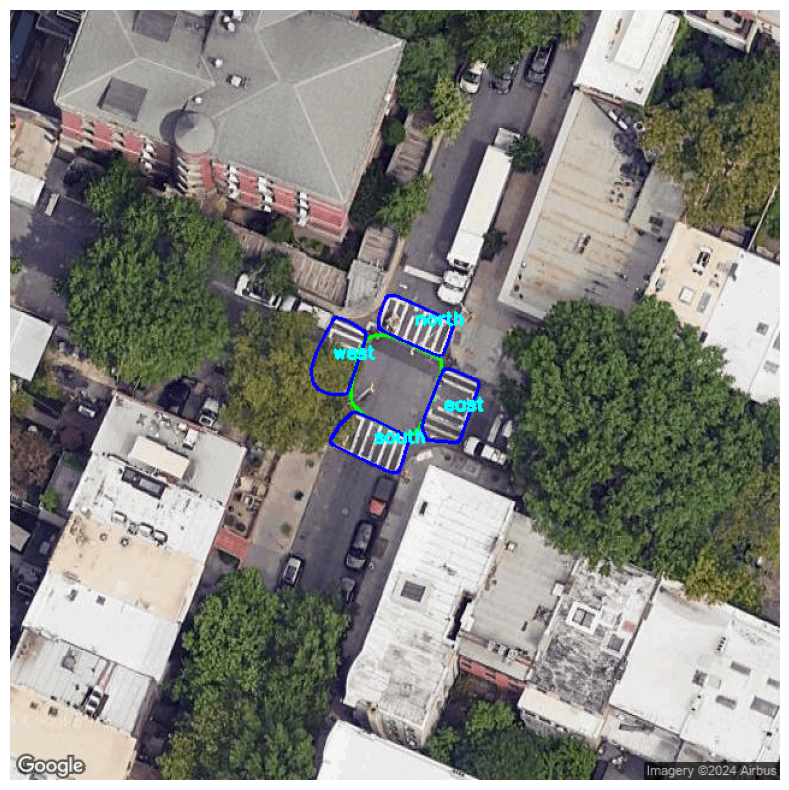

In [20]:
img_file_path = 'data/images/40.688_-73.997562.png'
visualize_crosswalk_directions(predictor, img_file_path, metadata, class_labels, fit_polygon_delaunay)

# Full Feature Extraction

In [21]:
def extract_features(predictions, class_labels, image_dims, epsilon=0.02, cw_dist_thrshold=10):
    """
    Extract features from predictions, including crosswalk assignments, orientations, and intersection dimensions.
    """
    # Setup
    features = {
        "intersection_count": 0,
        "crosswalk_count": 0,
        "bikeLane_count": 0,
        "parkingLane_count": 0,
        "doubleYellow_count": 0,
        "median_count": 0,
        "overhead_count": 0,
    }
    image_center = (image_dims[1] // 2, image_dims[0] // 2)  # (x_center, y_center)

    # Extract masks and classes
    instances = predictions["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()
    # boxes = instances.pred_boxes.tensor.numpy()

    # Step 1: Extract feature counts
    for i, cls in enumerate(classes):
        # Update feature counts
        features[f'{class_labels[cls]}_count'] += 1

    # Check if there are any intersections
    if features["intersection_count"] == 0:
        return features

    # Step 2: Extract intersection contours and find the main intersection
    intersection_contours = []
    main_intersection = None
    min_distance_to_center = float("inf")
    # Find main intersection instance
    for i, cls in enumerate(classes):
        if class_labels[cls] == "intersection":
            # Extract mask
            mask = masks[i]
            # Find contours
            contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if contours:
                contour = max(contours, key=cv2.contourArea)
                intersection_contours.append(contour)
                # Compute distance to image center
                M = cv2.moments(contour)
                cx = int(M["m10"] / M["m00"])
                cy = int(M["m01"] / M["m00"])
                distance_to_center = np.linalg.norm(np.array([cx, cy]) - np.array(image_center))
                # Assign to main intersection if it's the closest to the center
                if distance_to_center < min_distance_to_center:
                    min_distance_to_center = distance_to_center
                    main_intersection = {
                        "mask": mask,
                        "contour": contour,
                        "center": (cx, cy),
                        "box": cv2.boxPoints(cv2.minAreaRect(contour))  # Corners of the bounding box
                    }
    
    # Step 3: Add main intersection dimensions to features dict
    if main_intersection:
        contour = main_intersection["contour"]
        # Ensure contour is a 2D array of (x, y) points
        if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
        # Fit polygon, measure sides and assign directions
        polygon = fit_polygon_delaunay(contour)
        main_intersection["polygon"] = polygon
        side_lengths, _ = measure_intersection_sides(polygon)
        for direction, info in side_lengths.items():
            features[f'int_{direction}_side_length'] = info["length"]
        # for direction, length in side_lengths.items():
        #     features[f'int_{direction}_side_length'] = length

    # Step 4: Identify crosswalks at main intersection and measure dimensions
    crosswalk_counter = 0
    crosswalk_polygons = {}
    crosswalk_lengths = {}
    crosswalk_widths = {}
    for i, cls in enumerate(classes):
        if class_labels[cls] == "crosswalk":
            # Extract mask
            mask = masks[i].astype(np.uint8)
            # Find the largest contour
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            contour = max(contours, key=cv2.contourArea)
            # Ensure contour is a 2D array of (x, y) points
            if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
            # Check if the crosswalk is close to the main intersection
            close_to_intersection = False
            for point in contour:
                point_tuple = (int(point[0]), int(point[1]))
                distance = cv2.pointPolygonTest(main_intersection["contour"], point_tuple, True)
                if abs(distance) <= cw_dist_thrshold:  # Check if within certain number of pixels
                    close_to_intersection = True
                    crosswalk_counter += 1
                    break  # No need to check further
            # If close to intersection, add to main_int_crosswalks
            if close_to_intersection:
                polygon = fit_polygon_delaunay(contour)
                crosswalk_polygons[crosswalk_counter] = polygon
                length, width = measure_crosswalk_dimensions(polygon)
                crosswalk_lengths[crosswalk_counter] = length
                crosswalk_widths[crosswalk_counter] = width
        
        cw_direction = assign_crosswalks_to_directions(main_intersection["polygon"], crosswalk_polygons.values())
        for i, direction in zip(crosswalk_polygons.keys(), cw_direction):
            features[f'cw_{direction}_side_length'] = crosswalk_lengths[i]
            features[f'cw_{direction}_side_width'] = crosswalk_widths[i]

    return features

In [22]:
def main(image_files):
    predictor = setup_predictor()
    image_files = image_files # os.listdir(IMAGES_DIR)
    all_features = []
    for image_file in image_files:
        image_path = f'data/images/{image_file}' # os.path.join(IMAGES_DIR, image_file)
        image = cv2.imread(image_path)
        predictions = predictor(image)
        
        # Extract image dimensions
        image_dims = image.shape[:2]  # (height, width)
        
        # Extract features for this intersection
        features = extract_features(predictions, class_labels, image_dims)
        features["image_name"] = image_file.replace('.png', '')
        all_features.append(features)
    
    # Save results to a DataFrame
    df = pd.DataFrame(all_features)
    # df.to_csv(OUTPUT_DIR, index=False)

    return df, features

In [23]:
df, features = main(['40.68355_-73.98438.png'])
df.T

,0
intersection_count,1
crosswalk_count,4
bikeLane_count,0
parkingLane_count,0
doubleYellow_count,0
median_count,0
overhead_count,15
int_north_side_length,79.15807
int_south_side_length,93.037627
int_east_side_length,81.492331


In [24]:
features_meters = features.copy()

for key, value in features_meters.items():
    if 'length' in key or 'width' in key:
        features_meters[key] = value * 0.11

features_feet = features_meters.copy()

for key, value in features_feet.items():
    if 'length' in key or 'width' in key:
        features_feet[key] = value * 3.28084

features_feet

{'intersection_count': 1,
 'crosswalk_count': 4,
 'bikeLane_count': 0,
 'parkingLane_count': 0,
 'doubleYellow_count': 0,
 'median_count': 0,
 'overhead_count': 15,
 'int_north_side_length': 28.567545756523156,
 'int_south_side_length': 33.576572425039025,
 'int_east_side_length': 29.409962890025962,
 'int_west_side_length': 29.241193965705204,
 'cw_north_side_length': 28.927726476982393,
 'cw_north_side_width': 8.545498031643975,
 'cw_south_side_length': 25.805699322891577,
 'cw_south_side_width': 8.650688175129316,
 'cw_east_side_length': 30.265513383202112,
 'cw_east_side_width': 7.866537532275479,
 'cw_west_side_length': 35.051180848231205,
 'cw_west_side_width': 10.136713808329766,
 'image_name': '40.68355_-73.98438'}

In [25]:
def visualize_all_in_grid(img_file_path, predictor, metadata, class_labels, fit_function):
    """
    Visualize the outputs of four model visualization functions in a 2x2 grid.

    Parameters:
        img_file_path (str): Path to the input image file.
        predictor: Detectron2 predictor object.
        metadata: Metadata for visualizer.
        class_labels: List of class labels corresponding to class indices.
        fit_function: Polygon fitting function (e.g., fit_polygon_delaunay).
    """
    import matplotlib.pyplot as plt

    # Generate images from each visualize function
    img_predictions = visualize_model_predictions(predictor, img_file_path, metadata, plot=False)
    img_intersection = visualize_intersection_sides(predictor, img_file_path, metadata, class_labels, fit_function, plot=False)
    img_crosswalk_directions = visualize_crosswalk_directions(predictor, img_file_path, metadata, class_labels, fit_function, plot=False)
    img_crosswalk_measurements = visualize_crosswalk_measurements(predictor, img_file_path, metadata, class_labels, fit_function, plot=False)

    # Create a 2x2 grid
    fig, axs = plt.subplots(2, 2, figsize=(15, 15))

    # Add images to the grid
    axs[0, 0].imshow(img_predictions)
    axs[0, 0].set_title("Model Predictions")
    axs[0, 0].axis("off")

    axs[0, 1].imshow(img_intersection)
    axs[0, 1].set_title("Intersection Sides")
    axs[0, 1].axis("off")

    axs[1, 0].imshow(img_crosswalk_directions)
    axs[1, 0].set_title("Crosswalk Directions")
    axs[1, 0].axis("off")

    axs[1, 1].imshow(img_crosswalk_measurements)
    axs[1, 1].set_title("Crosswalk Measurements")
    axs[1, 1].axis("off")

    # Adjust layout and display
    plt.tight_layout()
    plt.show()

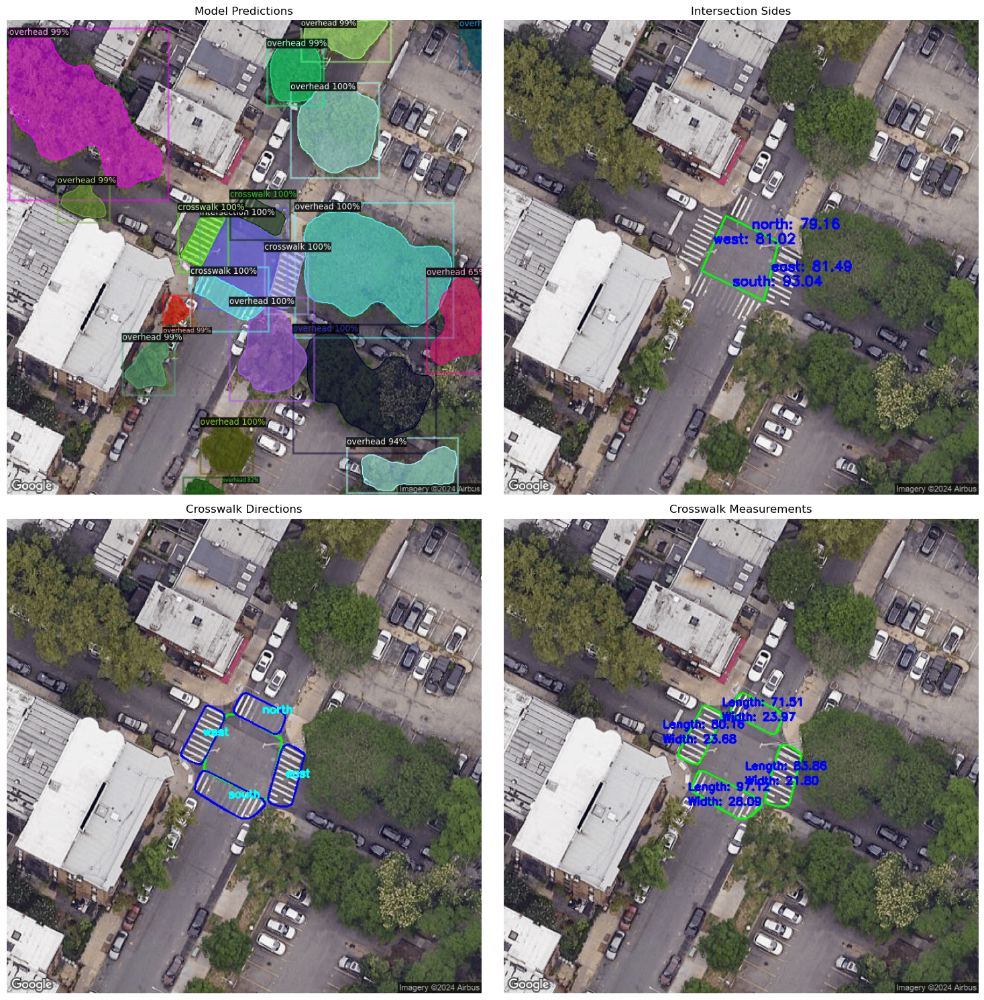

In [26]:
img_file_path = 'data/images/40.68355_-73.98438.png'
visualize_all_in_grid(img_file_path, predictor, metadata, class_labels, fit_polygon_delaunay)

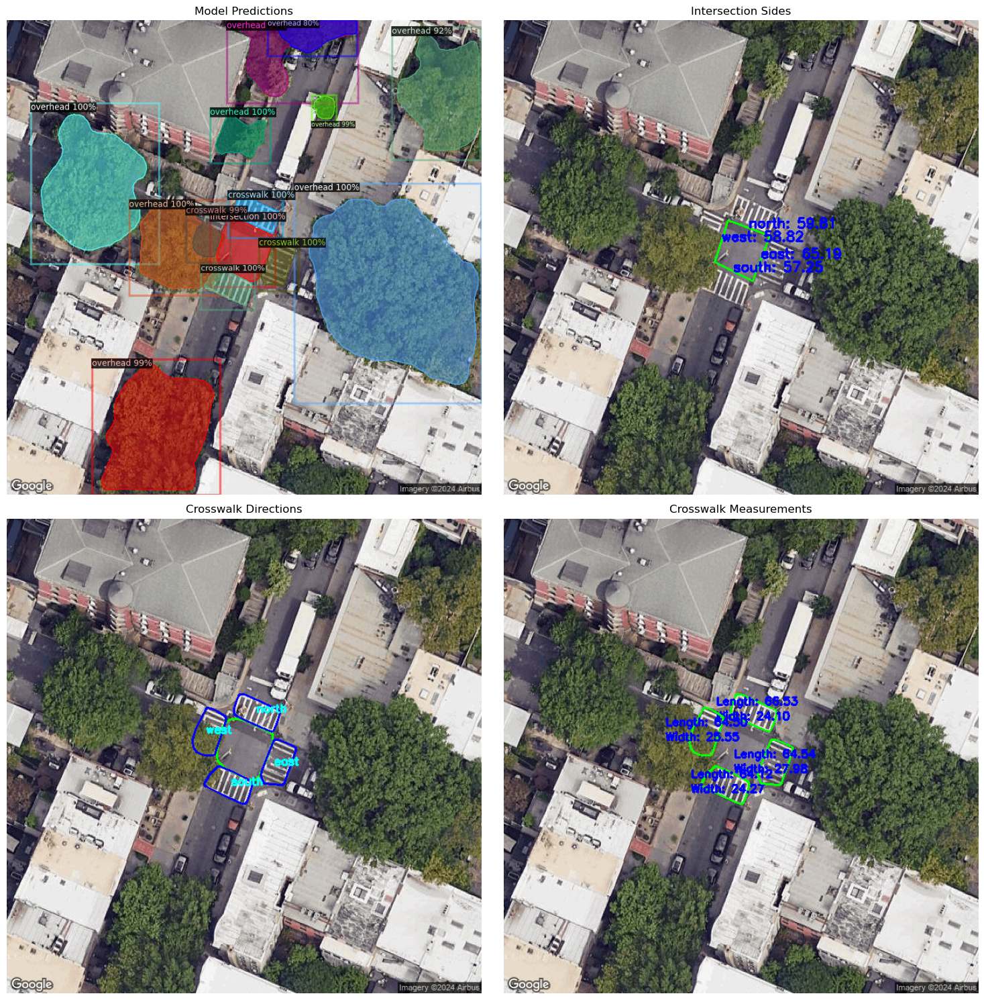

In [27]:
img_file_path = 'data/images/40.688_-73.997562.png'
visualize_all_in_grid(img_file_path, predictor, metadata, class_labels, fit_polygon_delaunay)

In [28]:
df, features = main(['40.688_-73.997562.png'])
df.T

,0
intersection_count,1
crosswalk_count,4
bikeLane_count,0
parkingLane_count,0
doubleYellow_count,0
median_count,0
overhead_count,9
int_north_side_length,59.808026
int_south_side_length,57.245087
int_east_side_length,65.192024


# OLD

In [29]:
def fit_four_sided_polygon(mask, max_iterations=20, epsilon_start=0.02, epsilon_step=0.005):
    """
    Fit a four-sided polygon to the contour of a segmentation mask.

    Parameters:
        mask (numpy.ndarray): Binary segmentation mask (0 for background, 255 for foreground).
        max_iterations (int): Maximum number of attempts to adjust epsilon to achieve 4 vertices.
        epsilon_start (float): Starting epsilon as a fraction of the arc length.
        epsilon_step (float): Step size for adjusting epsilon if not 4 vertices are found.

    Returns:
        tuple: (vertices, side_lengths)
            vertices (numpy.ndarray): Array of four vertices of the polygon.
            side_lengths (list): Lengths of the sides of the polygon.
    """
    # Ensure the mask is uint8
    if mask.dtype == np.bool_:
        mask = (mask * 255).astype(np.uint8)
    
    # Find contours in the mask
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        raise ValueError("No contours found in the mask.")

    # Choose the largest contour
    contour = max(contours, key=cv2.contourArea)
    
    # Iteratively adjust epsilon to fit a four-sided polygon
    epsilon = epsilon_start * cv2.arcLength(contour, True)
    for _ in range(max_iterations):
        # Approximate the contour with a polygon
        approx = cv2.approxPolyDP(contour, epsilon, True)
        
        if len(approx) == 4:
            # Successfully approximated as a quadrilateral
            vertices = approx.reshape(-1, 2)
            
            # Calculate side lengths
            side_lengths = []
            for i in range(4):
                pt1 = vertices[i]
                pt2 = vertices[(i + 1) % 4]  # Ensure the last point connects to the first
                length = np.linalg.norm(pt2 - pt1)
                side_lengths.append(length)
            
            return vertices, side_lengths
        
        # Adjust epsilon for the next iteration
        epsilon += epsilon_step * cv2.arcLength(contour, True)

    # If unable to approximate as a quadrilateral after max_iterations
    raise ValueError("Failed to approximate a four-sided polygon within the maximum iterations.")

In [30]:
def extract_features(predictions, class_labels, image_dims, epsilon=0.02, cw_dist_thrshold=20):
    """
    Extract features from predictions, including crosswalk assignments, orientations, and intersection dimensions.
    """
    # Setup
    features = {
        "intersection_count": 0,
        "crosswalk_count": 0,
        "bikeLane_count": 0,
        "parkingLane_count": 0,
        "doubleYellow_count": 0,
        "median_count": 0,
        "overhead_count": 0,
        "int_north_side_length": 0,
        "int_south_side_length": 0,
        "int_east_side_length": 0,
        "int_west_side_length": 0,
        # "cw_north_side_length": 0,
        # "cw_north_side_width": 0,
        # "cw_south_side_length": 0,
        # "cw_south_side_width": 0,
        # "cw_east_side_length": 0,
        # "cw_east_side_width": 0,
        # "cw_west_side_length": 0,
        # "cw_west_side_width": 0
        "cw1_length": 0,
        "cw1_width": 0,
        "cw2_length": 0,
        "cw2_width": 0,
        "cw3_length": 0,
        "cw3_width": 0,
        "cw4_length": 0,
        "cw4_width": 0
    }
    image_center = (image_dims[1] // 2, image_dims[0] // 2)  # (x_center, y_center)

    # Extract masks and classes
    instances = predictions["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()
    # boxes = instances.pred_boxes.tensor.numpy()

    # Step 1: Extract feature counts
    for i, cls in enumerate(classes):
        # Update feature counts
        features[f'{class_labels[cls]}_count'] += 1

    # Step 2: Extract intersection contours and find the main intersection
    intersection_contours = []
    main_intersection = None
    min_distance_to_center = float("inf")
    # Find intersection instances
    for i, cls in enumerate(classes):
        if class_labels[cls] == "intersection":
            # Find contours
            mask = masks[i]
            contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if contours:
                contour = contours[0]
                intersection_contours.append(contour)
                # Compute distance to image center
                M = cv2.moments(contour)
                cx = int(M["m10"] / M["m00"])
                cy = int(M["m01"] / M["m00"])
                distance_to_center = np.linalg.norm(np.array([cx, cy]) - np.array(image_center))
                # Assign to main intersection if it's the closest to the center
                if distance_to_center < min_distance_to_center:
                    min_distance_to_center = distance_to_center
                    main_intersection = {
                        "mask": mask,
                        "contour": contour,
                        "center": (cx, cy),
                        "box": cv2.boxPoints(cv2.minAreaRect(contour))  # Corners of the bounding box
                    }
    
    # Step 3: Add main intersection dimensions to features dict
    if main_intersection:
        # Calculate lengths of the main intersection's sides
        contour = main_intersection["contour"]
        simplified_contour = cv2.approxPolyDP(contours[0], epsilon * cv2.arcLength(contours[0], True), True)
        if len(simplified_contour) == 4:
            # Assign lengths to north, south, east, west
            # lengths = compute_lengths_and_widths(simplified_contour)
            vertices, lengths = fit_four_sided_polygon(main_intersection["mask"])
            features["int_north_side_length"] = lengths[0]
            features["int_south_side_length"] = lengths[1]
            features["int_east_side_length"] = lengths[2]
            features["int_west_side_length"] = lengths[3]

    # Step 4: Identify crosswalks at main intersection and measure dimensions
    crosswalk_counter = 0
    for i, cls in enumerate(classes):
        if class_labels[cls] == "crosswalk":
            # Find contours
            mask = masks[i].astype(np.uint8)
            # mask = mask.astype(np.uint8)
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            crosswalk_contour = max(contours, key=cv2.contourArea)  # Use the largest contour
            vertices, lengths = fit_four_sided_polygon(mask)
            if len(lengths) == 4:
                # Check proximity to intersection
                close_to_intersection = False
                # Check if any point in the crosswalk is within 10 pixels of the intersection
                for point in crosswalk_contour:
                    point_tuple = (int(point[0][0]), int(point[0][1])) # Extract (x, y) from the contour point
                    int_contour = main_intersection["contour"]
                    distance = cv2.pointPolygonTest(int_contour, point_tuple, True)
                    if abs(distance) <= cw_dist_thrshold:  # Check if within certain number of pixels
                        close_to_intersection = True
                        crosswalk_counter += 1
                        break  # No need to check further
                # If close to intersection, update crosswalk dimensions
                if close_to_intersection:
                    dim1 = np.max([lengths[0], lengths[2]])
                    dim2 = np.max([lengths[1], lengths[3]])
                    length = np.max([dim1, dim2])
                    width = np.min([dim1, dim2])
                    features[f'cw{crosswalk_counter}_length'] = length
                    features[f'cw{crosswalk_counter}_width'] = width
    
    return features

In [31]:
predictor = setup_predictor()
# home = ['40.68355', '-73.98438'] # '40.68355_-73.98438.png'
image_files = ['40.68355_-73.98438.png']  # '40.807773_-73.945482.png' - '40.682_-73.968664.png' # 40.88_-73.848331.png
all_features = []

for image_file in image_files:
    image_path = f'data/images/{image_file}'
    image = cv2.imread(image_path)
    predictions = predictor(image)
    
    # Extract image dimensions
    image_dims = image.shape[:2]  # (height, width)
    
    # Extract features for this intersection
    features = extract_features(predictions, class_labels, image_dims)
    features["image_name"] = image_file
    all_features.append(features)

# Save results to a DataFrame
df = pd.DataFrame(all_features)

features

{'intersection_count': 1,
 'crosswalk_count': 4,
 'bikeLane_count': 0,
 'parkingLane_count': 0,
 'doubleYellow_count': 0,
 'median_count': 0,
 'overhead_count': 15,
 'int_north_side_length': 81.02468759581859,
 'int_south_side_length': 93.03762679690406,
 'int_east_side_length': 81.49233092751734,
 'int_west_side_length': 79.1580697086532,
 'cw1_length': 72.56031973468694,
 'cw1_width': 28.844410203711913,
 'cw2_length': 63.90618123468183,
 'cw2_width': 27.0,
 'cw3_length': 77.62087348130012,
 'cw3_width': 32.7566787083184,
 'cw4_length': 91.30169768410661,
 'cw4_width': 36.89173349139343,
 'image_name': '40.68355_-73.98438.png'}

In [32]:
features_meters = features.copy()

for key, value in features_meters.items():
    if 'length' in key or 'width' in key:
        features_meters[key] = value * 0.11

features_feet = features_meters.copy()

for key, value in features_feet.items():
    if 'length' in key or 'width' in key:
        features_feet[key] = value * 3.28084

features_feet

{'intersection_count': 1,
 'crosswalk_count': 4,
 'bikeLane_count': 0,
 'parkingLane_count': 0,
 'doubleYellow_count': 0,
 'median_count': 0,
 'overhead_count': 15,
 'int_north_side_length': 29.241193965705204,
 'int_south_side_length': 33.576572425039025,
 'int_east_side_length': 29.409962890025962,
 'int_west_side_length': 28.567545756523156,
 'cw1_length': 26.186467933818534,
 'cw1_width': 10.409728425002081,
 'cw2_length': 23.06325512061929,
 'cw2_width': 9.744094800000001,
 'cw3_length': 28.012783320762754,
 'cw3_width': 11.821636395073927,
 'cw4_length': 32.95008880129168,
 'cw4_width': 13.313946239869354,
 'image_name': '40.68355_-73.98438.png'}

In [33]:
features_meters

{'intersection_count': 1,
 'crosswalk_count': 4,
 'bikeLane_count': 0,
 'parkingLane_count': 0,
 'doubleYellow_count': 0,
 'median_count': 0,
 'overhead_count': 15,
 'int_north_side_length': 8.912715635540046,
 'int_south_side_length': 10.234138947659448,
 'int_east_side_length': 8.964156402026909,
 'int_west_side_length': 8.707387667951853,
 'cw1_length': 7.981635170815563,
 'cw1_width': 3.1728851224083106,
 'cw2_length': 7.029679935815001,
 'cw2_width': 2.97,
 'cw3_length': 8.538296082943013,
 'cw3_width': 3.603234657915024,
 'cw4_length': 10.043186745251727,
 'cw4_width': 4.058090684053277,
 'image_name': '40.68355_-73.98438.png'}

In [34]:
def visual_predictions(predictor, img_file_path, metadata):
    img = cv2.imread(img_file_path)
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    plt.figure(figsize=(15, 10))
    plt.imshow(v.get_image())
    plt.axis("off")
    plt.show()

annotation_file = "data/annotations/dataset.json"
image_path = "data/images/"
register_coco_instances("clean_train", {}, annotation_file, image_path)

# Verify dataset registration
metadata = MetadataCatalog.get("clean_train")
dataset_dicts = DatasetCatalog.get("clean_train")


Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



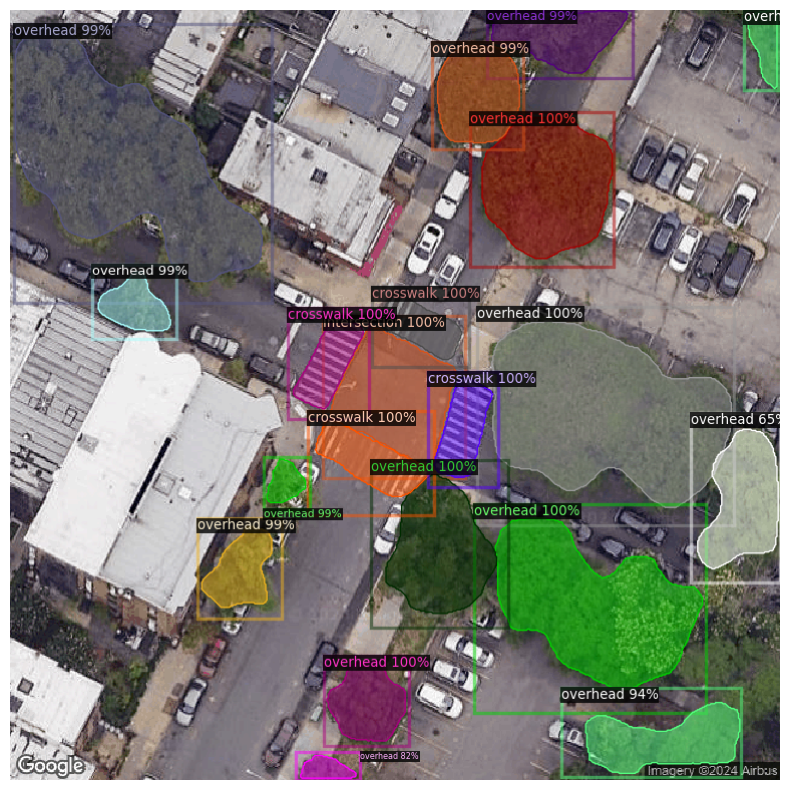

In [35]:
img_file_path = 'data/images/40.68355_-73.98438.png' # 40.807773_-73.945482.png
visual_predictions(predictor, img_file_path, metadata)

In [36]:
def visualize_fitted_polygon(predictor, img_file_path, metadata, class_labels):
    """
    Visualize fitted four-sided polygons overlaid on model predictions.
    
    Parameters:
        predictor: Detectron2 predictor object.
        img_file_path (str): Path to the image file.
        metadata: Metadata object for visualizer.
        class_labels (list): List of class labels corresponding to class indices in predictions.
    """
    import cv2
    import matplotlib.pyplot as plt
    import numpy as np
    from detectron2.utils.visualizer import Visualizer
    
    # Read the image
    img = cv2.imread(img_file_path)
    outputs = predictor(img)

    # Initialize the visualizer
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Extract predictions
    instances = outputs["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()

    # Copy the image to overlay polygons
    img_with_polygon = img.copy()

    # Iterate through masks and fit polygons
    for i, cls in enumerate(classes):
        # Only process certain classes (e.g., intersections, crosswalks)
        if class_labels[cls] not in ["intersection", "crosswalk"]:
            continue
        
        mask = masks[i].astype(np.uint8)  # Ensure mask is binary
        try:
            # Fit the polygon to the mask
            vertices, side_lengths = fit_four_sided_polygon(mask)
            
            # Draw the polygon on the image
            for j in range(4):
                pt1 = tuple(vertices[j])
                pt2 = tuple(vertices[(j + 1) % 4])
                cv2.line(img_with_polygon, pt1, pt2, (0, 255, 0), 2)  # Green lines for polygons

            # Optionally, label the polygon with side lengths
            for j, vertex in enumerate(vertices):
                text = f"{side_lengths[j]:.1f}"
                cv2.putText(
                    img_with_polygon, text, tuple(vertex),
                    fontFace=cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=0.5,
                    color=(255, 0, 0), thickness=1, lineType=cv2.LINE_AA
                )
        except ValueError as e:
            print(f"Skipping mask {i} ({class_labels[cls]}): {e}")

    # Plot the original predictions and the polygons
    fig, axs = plt.subplots(1, 2, figsize=(20, 10))
    axs[0].imshow(v.get_image())
    axs[0].set_title("Original Predictions")
    axs[0].axis("off")

    axs[1].imshow(cv2.cvtColor(img_with_polygon, cv2.COLOR_BGR2RGB))
    axs[1].set_title("Fitted Polygons")
    axs[1].axis("off")

    plt.tight_layout()
    plt.show()

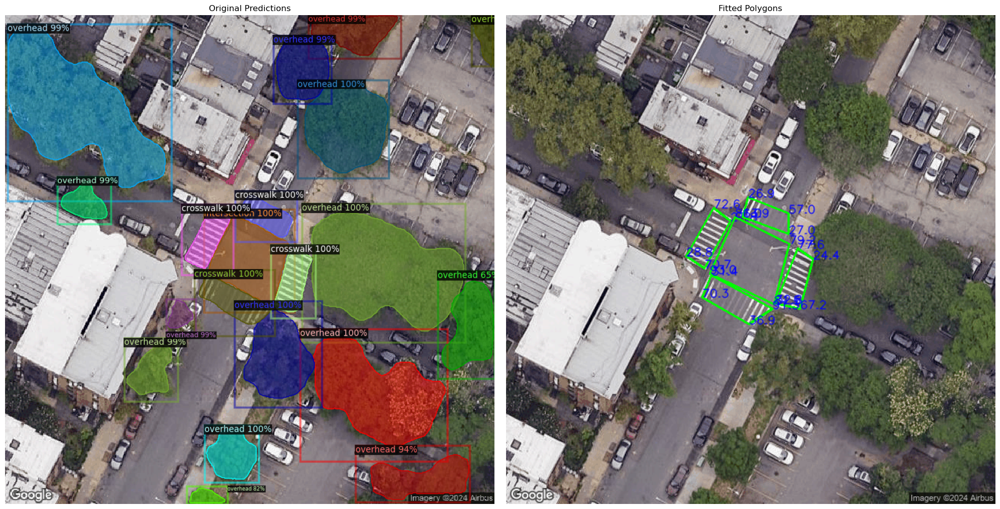

In [37]:
visualize_fitted_polygon(predictor, img_file_path, metadata, class_labels)

In [38]:
def visualize_polygon(predictor, img_file_path, metadata, class_labels, fit_function):
    """
    Visualize a polygon fitted to the masks using the specified fitting function.
    
    Parameters:
        predictor: Detectron2 predictor object.
        img_file_path (str): Path to the image file.
        metadata: Metadata object for visualizer.
        class_labels (list): List of class labels corresponding to class indices in predictions.
        fit_function (function): Polygon fitting function to use 
                                 (e.g., fit_four_sided_polygon, fit_polygon_least_squares, fit_polygon_delaunay).
    """
    import cv2
    import matplotlib.pyplot as plt
    import numpy as np
    from detectron2.utils.visualizer import Visualizer

    # Read the image
    img = cv2.imread(img_file_path)
    outputs = predictor(img)

    # Initialize the visualizer
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Extract predictions
    instances = outputs["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()

    # Copy the image for overlay
    img_with_polygon = img.copy()

    # Iterate through masks and apply the fitting function
    for i, cls in enumerate(classes):
        # Only process certain classes (e.g., intersections, crosswalks)
        if class_labels[cls] not in ["intersection", "crosswalk"]:
            continue
        
        mask = masks[i].astype(np.uint8)  # Ensure mask is binary
        try:
            # Use the provided fitting function
            if fit_function == fit_four_sided_polygon:
                vertices, side_lengths = fit_function(mask)
            else:
                contour = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)[0]
                contour = contour[0] if isinstance(contour, tuple) else contour  # Handle OpenCV's return format
                vertices = fit_function(contour)

            # Draw the polygon on the image
            vertices = np.int32(vertices)  # Ensure integer values
            for j in range(len(vertices)):
                pt1 = tuple(vertices[j])
                pt2 = tuple(vertices[(j + 1) % len(vertices)])
                cv2.line(img_with_polygon, pt1, pt2, (0, 255, 0), 2)  # Green lines for polygons

            # Optionally, annotate the polygon vertices
            for j, vertex in enumerate(vertices):
                cv2.putText(
                    img_with_polygon, f"V{j+1}", tuple(vertex),
                    fontFace=cv2.FONT_HERSHEY_SIMPLEX,
                    fontScale=0.5,
                    color=(255, 0, 0), thickness=1, lineType=cv2.LINE_AA
                )
        except Exception as e:
            print(f"Skipping mask {i} ({class_labels[cls]}): {e}")

    # Plot the original predictions and the polygons
    fig, axs = plt.subplots(1, 2, figsize=(20, 10))
    axs[0].imshow(v.get_image())
    axs[0].set_title("Original Predictions")
    axs[0].axis("off")

    axs[1].imshow(cv2.cvtColor(img_with_polygon, cv2.COLOR_BGR2RGB))
    axs[1].set_title("Fitted Polygons")
    axs[1].axis("off")

    plt.tight_layout()
    plt.show()

In [39]:
import numpy as np
import cv2
from scipy.spatial import Delaunay

def fit_polygon_delaunay(contour):
    """
    Fit a polygon using Delaunay triangulation.

    Parameters:
        contour (numpy.ndarray): Contour points (Nx2 array).

    Returns:
        numpy.ndarray: Array of vertices of the fitted polygon.
    """
    # Delaunay triangulation
    points = contour[:, 0, :]  # Extract (x, y) from the contour points
    tri = Delaunay(points)

    # Extract the convex hull (outermost polygon)
    hull_indices = cv2.convexHull(points, returnPoints=False).flatten()
    hull_points = points[hull_indices]

    return hull_points


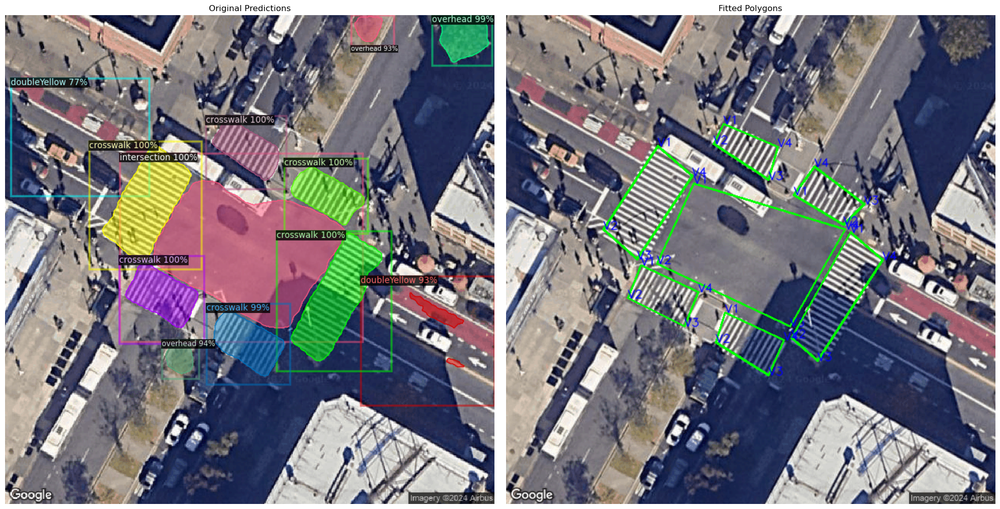

In [40]:
img_file_path = 'data/images/40.807773_-73.945482.png'
visualize_polygon(predictor, img_file_path, metadata, class_labels, fit_four_sided_polygon)

In [41]:
# visualize_polygon(predictor, img_file_path, metadata, class_labels, fit_polygon_least_squares)

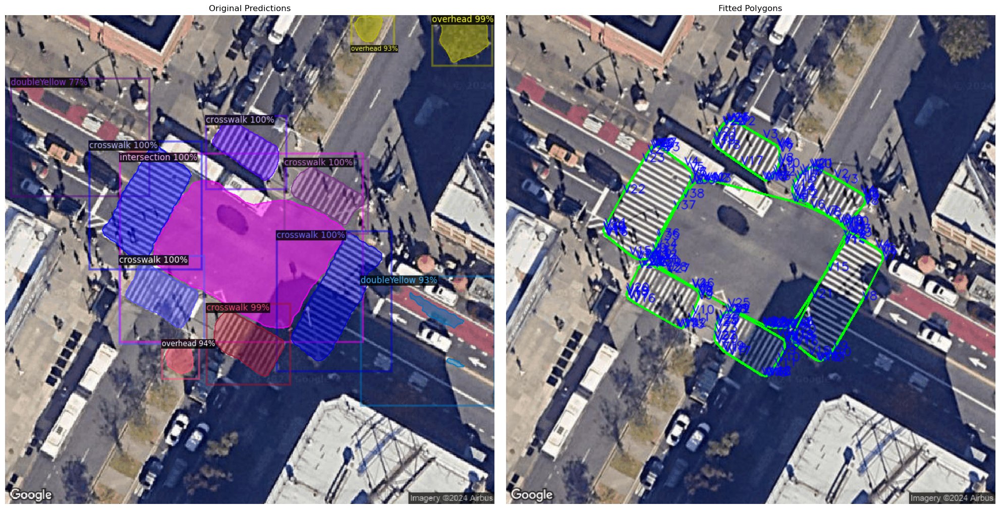

In [42]:
visualize_polygon(predictor, img_file_path, metadata, class_labels, fit_polygon_delaunay)

In [43]:
def measure_crosswalk_dimensions(polygon):
    """
    Measure the length and width of a crosswalk from a polygon.

    Parameters:
        polygon (numpy.ndarray): Nx2 array of polygon vertices.

    Returns:
        tuple: (length, width)
            length (float): Longest distance between two vertices (distance pedestrians walk).
            width (float): Shortest distance across the polygon (space available for pedestrians).
    """
    # Step 1: Simplify the polygon using a convex hull
    hull = ConvexHull(polygon)
    hull_points = polygon[hull.vertices]

    # Step 2: Calculate all pairwise distances between hull points
    num_points = len(hull_points)
    pairwise_distances = []
    for i in range(num_points):
        for j in range(i + 1, num_points):
            dist = np.linalg.norm(hull_points[i] - hull_points[j])
            pairwise_distances.append((dist, i, j))

    # Step 3: Identify the longest distance (length)
    pairwise_distances = sorted(pairwise_distances, key=lambda x: -x[0])  # Sort by descending distance
    length, idx1, idx2 = pairwise_distances[0]  # Longest distance and its endpoints
    longest_axis = (hull_points[idx1], hull_points[idx2])

    # Step 4: Calculate perpendicular distances to the longest axis (width)
    def point_to_line_distance(point, line_start, line_end):
        line_vec = line_end - line_start
        point_vec = point - line_start
        line_len = np.linalg.norm(line_vec)
        if line_len == 0:
            return np.linalg.norm(point_vec)
        projection = np.dot(point_vec, line_vec) / line_len
        proj_point = line_start + projection * (line_vec / line_len)
        return np.linalg.norm(point - proj_point)

    # Measure perpendicular distances from all hull points to the longest axis
    line_start, line_end = longest_axis
    perpendicular_distances = [
        point_to_line_distance(pt, line_start, line_end) for pt in hull_points if not np.array_equal(pt, line_start) and not np.array_equal(pt, line_end)
    ]
    width = max(perpendicular_distances) if perpendicular_distances else 0  # Take the largest perpendicular distance as width

    return length, width

def visualize_crosswalk_measurements(predictor, img_file_path, metadata, class_labels, fit_function):
    """
    Visualize crosswalk measurements (length and width) based on the fitted polygon.

    Parameters:
        predictor: Detectron2 predictor object.
        img_file_path (str): Path to the image file.
        metadata: Metadata object for the visualizer.
        class_labels: List of class labels corresponding to class indices.
        fit_function: Polygon fitting function (e.g., fit_polygon_delaunay).
    """
    import cv2
    import matplotlib.pyplot as plt

    # Read the image
    img = cv2.imread(img_file_path)
    outputs = predictor(img)

    # Initialize the visualizer
    from detectron2.utils.visualizer import Visualizer
    v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.2)
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Extract predictions
    instances = outputs["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()

    # Overlay length and width measurements
    for i, cls in enumerate(classes):
        if class_labels[cls] == "crosswalk":
            mask = masks[i].astype(np.uint8)
            
            # Find contours
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if not contours:
                continue  # Skip if no contours are found
            
            # Use the largest contour
            contour = max(contours, key=cv2.contourArea)

            # Ensure contour is a 2D array of (x, y) points
            if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)

            # Fit polygon using the provided fitting function
            vertices = fit_function(contour)

            # Measure dimensions
            length, width = measure_crosswalk_dimensions(vertices)

            # Draw the fitted polygon on the image
            for j in range(len(vertices)):
                pt1 = tuple(vertices[j])
                pt2 = tuple(vertices[(j + 1) % len(vertices)])  # Wrap around to the first vertex
                cv2.line(img, pt1, pt2, (0, 255, 0), 2)  # Green lines for polygons

            # Annotate measurements
            midpoint = tuple(np.mean(vertices, axis=0).astype(int))  # Find the polygon's center
            cv2.putText(img, f"Length: {length:.2f}", (midpoint[0] - 50, midpoint[1] - 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
            cv2.putText(img, f"Width: {width:.2f}", (midpoint[0] - 50, midpoint[1] + 10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    # Show the results
    plt.figure(figsize=(15, 10))
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()

In [44]:
# def fit_polygon_delaunay(contour):
#     """
#     Fit a polygon using Delaunay triangulation.

#     Parameters:
#         contour (numpy.ndarray): Contour points as a 2D array (N, 2).

#     Returns:
#         numpy.ndarray: Array of vertices of the fitted polygon.
#     """
#     # Ensure contour is 2D
#     if contour.ndim != 2 or contour.shape[1] != 2:
#         raise ValueError("Contour must be a 2D array with shape (N, 2).")

#     # Delaunay triangulation
#     tri = Delaunay(contour)

#     # Extract the convex hull (outermost polygon)
#     hull_indices = cv2.convexHull(contour, returnPoints=False).flatten()
#     hull_points = contour[hull_indices]

#     return hull_points

In [45]:
# img_file_path = 'data/images/40.68355_-73.98438.png'
# visualize_crosswalk_measurements(predictor, img_file_path, metadata, class_labels, fit_polygon_delaunay)

In [65]:
from scripts.is_model_inference import *

model_file_path = 'models/model_final.pth'
num_classes = len(coco_data['categories'])
predictor = setup_predictor(model_file_path, num_classes, threshold=0.5)

image_file = '40.88_-73.848331.png'
image_file_path = os.path.join(IMAGES_DIR, image_file)
image = cv2.imread(image_file_path)
predictions = predictor(image)
extract_features(predictions, class_labels, image_dims, cw_dist_thrshold=10)

{'intersection_count': 2,
 'crosswalk_count': 7,
 'bikeLane_count': 3,
 'parkingLane_count': 0,
 'doubleYellow_count': 2,
 'median_count': 0,
 'overhead_count': 4,
 'overpass_count': 0,
 'int_north_side_length': 99.12618221237011,
 'int_south_side_length': 79.63039620647382,
 'int_east_side_length': 71.34423592694787,
 'int_west_side_length': 79.90619500389191,
 'cw_north_side_length': 107.2240644631605,
 'cw_north_side_width': 26.495917816807765,
 'cw_south_side_length': 79.02531240052139,
 'cw_south_side_width': 31.09130385397616}

In [66]:
def extract_features_2(predictions, class_labels, image_dims, cw_dist_thrshold=10, other_dist_thrshold=50):
    """
    Extract features from predictions, including crosswalk assignments, orientations, and intersection dimensions.
    """
    # Setup
    features = {f'{k}_count': 0 for k in class_labels}
    image_center = (image_dims[1] // 2, image_dims[0] // 2)  # (x_center, y_center)
    total_area = image_dims[0] * image_dims[1]

    # Extract masks and classes
    instances = predictions["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()

    # Smooth masks
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    for i, mask in enumerate(masks):
        mask = (mask * 255).astype(np.uint8)
        morphed_mask = cv2.dilate(mask, kernel, iterations=1)
        morphed_mask = cv2.morphologyEx(morphed_mask, cv2.MORPH_CLOSE, kernel)
        masks[i] = morphed_mask

    # Step 1: Check for intersections
    for i, cls in enumerate(classes):
        if class_labels[cls] == "intersection":
            features["intersection_count"] += 1

    # Check if there are any intersections
    if features["intersection_count"] == 0:
        return features

    # Step 2: Extract intersection contours and find the main intersection
    intersection_contours = []
    main_intersection = None
    min_distance_to_center = float("inf")
    # Find main intersection instance
    for i, cls in enumerate(classes):
        if class_labels[cls] == "intersection":
            # Extract mask
            mask = masks[i]
            # Find contours
            contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if contours:
                contour = max(contours, key=cv2.contourArea)
                intersection_contours.append(contour)
                # Compute distance to image center
                M = cv2.moments(contour)
                cx = int(M["m10"] / M["m00"])
                cy = int(M["m01"] / M["m00"])
                distance_to_center = np.linalg.norm(np.array([cx, cy]) - np.array(image_center))
                # Assign to main intersection if it's the closest to the center
                if distance_to_center < min_distance_to_center:
                    min_distance_to_center = distance_to_center
                    main_intersection = {
                        "mask": mask,
                        "contour": contour,
                        "center": (cx, cy),
                        "box": cv2.boxPoints(cv2.minAreaRect(contour))  # Corners of the bounding box
                    }
    
    # Step 3: Add main intersection dimensions to features dict
    if main_intersection:
        contour = main_intersection["contour"]
        # Ensure contour is a 2D array of (x, y) points
        if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
        # Fit polygon, measure sides and assign directions
        polygon = fit_polygon_delaunay(contour)
        main_intersection["polygon"] = polygon
        side_lengths, _ = measure_intersection_sides(polygon)
        for direction, info in side_lengths.items():
            features[f'int_{direction}_side_length'] = info["length"]

    # Step 4: Identify crosswalks at main intersection and measure dimensions
    crosswalk_counter = 0
    crosswalk_polygons = {}
    crosswalk_lengths = {}
    crosswalk_widths = {}
    for i, cls in enumerate(classes):
        if class_labels[cls] == "crosswalk":
            # Extract mask
            mask = masks[i].astype(np.uint8)
            # Find the largest contour
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            contour = max(contours, key=cv2.contourArea)
            # Ensure contour is a 2D array of (x, y) points
            if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
            # Check if the crosswalk is close to the main intersection
            close_to_intersection = False
            for point in contour:
                point_tuple = (int(point[0]), int(point[1]))
                distance = cv2.pointPolygonTest(main_intersection["contour"], point_tuple, True)
                if abs(distance) <= cw_dist_thrshold:  # Check if within certain number of pixels
                    close_to_intersection = True
                    break  # No need to check further
            # If close to intersection, add to main_int_crosswalks
            if close_to_intersection:
                polygon = fit_polygon_delaunay(contour)
                length, width = measure_crosswalk_dimensions(polygon)
                crosswalk_polygons[crosswalk_counter] = polygon
                crosswalk_lengths[crosswalk_counter] = length
                crosswalk_widths[crosswalk_counter] = width
                crosswalk_counter += 1
                features['crosswalk_count'] += 1
        
        cw_direction = assign_crosswalks_to_directions(main_intersection["polygon"], crosswalk_polygons.values())
        for i, direction in zip(crosswalk_polygons.keys(), cw_direction):
            features[f'cw_{direction}_side_length'] = crosswalk_lengths[i]
            features[f'cw_{direction}_side_width'] = crosswalk_widths[i]

    # Step 5: Count other road features
    for i, cls in enumerate(classes):
        if class_labels[cls] not in ['crosswalk', 'intersection']:
            # Extract mask
            mask = masks[i].astype(np.uint8)
            if not np.any(mask):
                continue
            # Find the largest contour
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if not contours:
                unified_mask = np.zeros_like(mask)
                cv2.drawContours(unified_mask, contours, -1, 255, thickness=cv2.FILLED)
                contours, _ = cv2.findContours(unified_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            contour = max(contours, key=cv2.contourArea)
            # Ensure contour is a 2D array of (x, y) points
            if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
            # Check if the crosswalk is close to the main intersection
            close_to_intersection = False
            for point in contour:
                point_tuple = (int(point[0]), int(point[1]))
                distance = cv2.pointPolygonTest(main_intersection["contour"], point_tuple, True)
                if abs(distance) <= other_dist_thrshold:  # Check if within certain number of pixels
                    close_to_intersection = True
                    crosswalk_counter += 1
                    break  # No need to check further
            # If close to intersection, add to main_int_crosswalks
            if close_to_intersection:
                features[f'{class_labels[cls]}_count'] += 1

    # Step 6: Calculate overhead features
    areas = {'overhead': 0, 'overpass': 0}
    for i, cls in enumerate(classes):
        if class_labels[cls] in ['overhead', 'overpass']:
            mask = masks[i].astype(np.uint8)
            areas[f'{class_labels[cls]}'] += np.sum(mask)
            if mask[image_center[1], image_center[0]]:
                features[f'{class_labels[cls]}_center'] = 1
    for key, value in areas.items():
        features[f'{key}_area'] = value / total_area

    return features

In [67]:
extract_features_2(predictions, class_labels, image_dims, cw_dist_thrshold=10)

{'intersection_count': 2,
 'crosswalk_count': 2,
 'overhead_count': 1,
 'median_count': 0,
 'doubleYellow_count': 0,
 'bikeLane_count': 0,
 'overpass_count': 0,
 'busLane_count': 0,
 'int_north_side_length': 102.57680049601859,
 'int_south_side_length': 82.92767933567175,
 'int_east_side_length': 74.79304780526061,
 'int_west_side_length': 82.75868534480233,
 'cw_north_side_length': 112.36102527122117,
 'cw_north_side_width': 28.168130295716043,
 'cw_south_side_length': 84.64632301523794,
 'cw_south_side_width': 33.988481690835926,
 'overhead_area': 0.04379150390625,
 'overpass_area': 0.0}

In [68]:
def extract_features_2(image_file_path, predictor, class_labels, cw_dist_thrshold=10, other_dist_thrshold=50):
    """
    Extract features from predictions, including crosswalk assignments, orientations, and intersection dimensions.
    """
    # Load image and make predictions
    image = cv2.imread(image_file_path)
    image_dims = image.shape[:2]  # (height, width)
    predictions = predictor(image)

    # Setup
    features = {f'{k}_count': 0 for k in class_labels}
    image_center = (image_dims[1] // 2, image_dims[0] // 2)  # (x_center, y_center)
    total_area = image_dims[0] * image_dims[1]

    # Extract masks and classes
    instances = predictions["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()

    # Smooth masks
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    for i, mask in enumerate(masks):
        mask = (mask * 255).astype(np.uint8)
        morphed_mask = cv2.dilate(mask, kernel, iterations=1)
        morphed_mask = cv2.morphologyEx(morphed_mask, cv2.MORPH_CLOSE, kernel)
        masks[i] = morphed_mask

    # Step 1: Check for intersections
    for i, cls in enumerate(classes):
        if class_labels[cls] == "intersection":
            features["intersection_count"] += 1

    # Check if there are any intersections
    if features["intersection_count"] == 0:
        return features

    # Step 2: Extract intersection contours and find the main intersection
    intersection_contours = []
    main_intersection = None
    min_distance_to_center = float("inf")
    # Find main intersection instance
    for i, cls in enumerate(classes):
        if class_labels[cls] == "intersection":
            # Extract mask
            mask = masks[i]
            # Find contours
            contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if contours:
                contour = max(contours, key=cv2.contourArea)
                intersection_contours.append(contour)
                # Compute distance to image center
                M = cv2.moments(contour)
                cx = int(M["m10"] / M["m00"])
                cy = int(M["m01"] / M["m00"])
                distance_to_center = np.linalg.norm(np.array([cx, cy]) - np.array(image_center))
                # Assign to main intersection if it's the closest to the center
                if distance_to_center < min_distance_to_center:
                    min_distance_to_center = distance_to_center
                    main_intersection = {
                        "mask": mask,
                        "contour": contour,
                        "center": (cx, cy),
                        "box": cv2.boxPoints(cv2.minAreaRect(contour))  # Corners of the bounding box
                    }
    
    # Step 3: Add main intersection dimensions to features dict
    if main_intersection:
        contour = main_intersection["contour"]
        # Ensure contour is a 2D array of (x, y) points
        if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
        # Fit polygon, measure sides and assign directions
        polygon = fit_polygon_delaunay(contour)
        main_intersection["polygon"] = polygon
        side_lengths, _ = measure_intersection_sides(polygon)
        for direction, info in side_lengths.items():
            features[f'int_{direction}_side_length'] = info["length"]

    # Step 4: Identify crosswalks at main intersection and measure dimensions
    crosswalk_counter = 0
    crosswalk_polygons = {}
    crosswalk_lengths = {}
    crosswalk_widths = {}
    for i, cls in enumerate(classes):
        if class_labels[cls] == "crosswalk":
            # Extract mask
            mask = masks[i].astype(np.uint8)
            # Find the largest contour
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            contour = max(contours, key=cv2.contourArea)
            # Ensure contour is a 2D array of (x, y) points
            if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
            # Check if the crosswalk is close to the main intersection
            close_to_intersection = False
            for point in contour:
                point_tuple = (int(point[0]), int(point[1]))
                distance = cv2.pointPolygonTest(main_intersection["contour"], point_tuple, True)
                if abs(distance) <= cw_dist_thrshold:  # Check if within certain number of pixels
                    close_to_intersection = True
                    break  # No need to check further
            # If close to intersection, add to main_int_crosswalks
            if close_to_intersection:
                polygon = fit_polygon_delaunay(contour)
                length, width = measure_crosswalk_dimensions(polygon)
                crosswalk_polygons[crosswalk_counter] = polygon
                crosswalk_lengths[crosswalk_counter] = length
                crosswalk_widths[crosswalk_counter] = width
                crosswalk_counter += 1
                features['crosswalk_count'] += 1
        
        cw_direction = assign_crosswalks_to_directions(main_intersection["polygon"], crosswalk_polygons.values())
        for i, direction in zip(crosswalk_polygons.keys(), cw_direction):
            features[f'cw_{direction}_side_length'] = crosswalk_lengths[i]
            features[f'cw_{direction}_side_width'] = crosswalk_widths[i]

    # Step 5: Count other road features
    for i, cls in enumerate(classes):
        if class_labels[cls] not in ['crosswalk', 'intersection']:
            # Extract mask
            mask = masks[i].astype(np.uint8)
            if not np.any(mask):
                continue
            # Find the largest contour
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if not contours:
                unified_mask = np.zeros_like(mask)
                cv2.drawContours(unified_mask, contours, -1, 255, thickness=cv2.FILLED)
                contours, _ = cv2.findContours(unified_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            contour = max(contours, key=cv2.contourArea)
            # Ensure contour is a 2D array of (x, y) points
            if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
            # Check if the crosswalk is close to the main intersection
            close_to_intersection = False
            for point in contour:
                point_tuple = (int(point[0]), int(point[1]))
                distance = cv2.pointPolygonTest(main_intersection["contour"], point_tuple, True)
                if abs(distance) <= other_dist_thrshold:  # Check if within certain number of pixels
                    close_to_intersection = True
                    crosswalk_counter += 1
                    break  # No need to check further
            # If close to intersection, add to main_int_crosswalks
            if close_to_intersection:
                features[f'{class_labels[cls]}_count'] += 1

    # Step 6: Calculate overhead features
    areas = {'overhead': 0, 'overpass': 0}
    for i, cls in enumerate(classes):
        if class_labels[cls] in ['overhead', 'overpass']:
            mask = masks[i].astype(np.uint8)
            areas[f'{class_labels[cls]}'] += np.sum(mask)
            if mask[image_center[1], image_center[0]]:
                features[f'{class_labels[cls]}_center'] = 1
    for key, value in areas.items():
        features[f'{key}_area'] = value / total_area

    return features

In [69]:
extract_features_2(image_file_path, predictor, class_labels)

{'intersection_count': 2,
 'crosswalk_count': 2,
 'overhead_count': 1,
 'median_count': 0,
 'doubleYellow_count': 0,
 'bikeLane_count': 0,
 'overpass_count': 0,
 'busLane_count': 0,
 'int_north_side_length': 102.57680049601859,
 'int_south_side_length': 82.92767933567175,
 'int_east_side_length': 74.79304780526061,
 'int_west_side_length': 82.75868534480233,
 'cw_north_side_length': 112.36102527122117,
 'cw_north_side_width': 28.168130295716043,
 'cw_south_side_length': 84.64632301523794,
 'cw_south_side_width': 33.988481690835926,
 'overhead_area': 0.04379150390625,
 'overpass_area': 0.0}

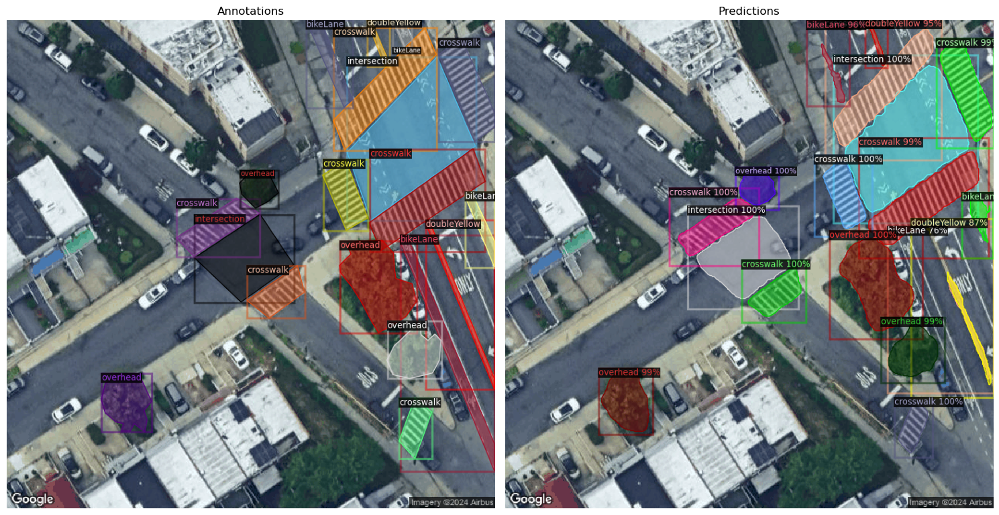

In [70]:
visualize_annotations_predictions_grid(image_file_path, predictor, metadata, dataset_dicts, plot=True)

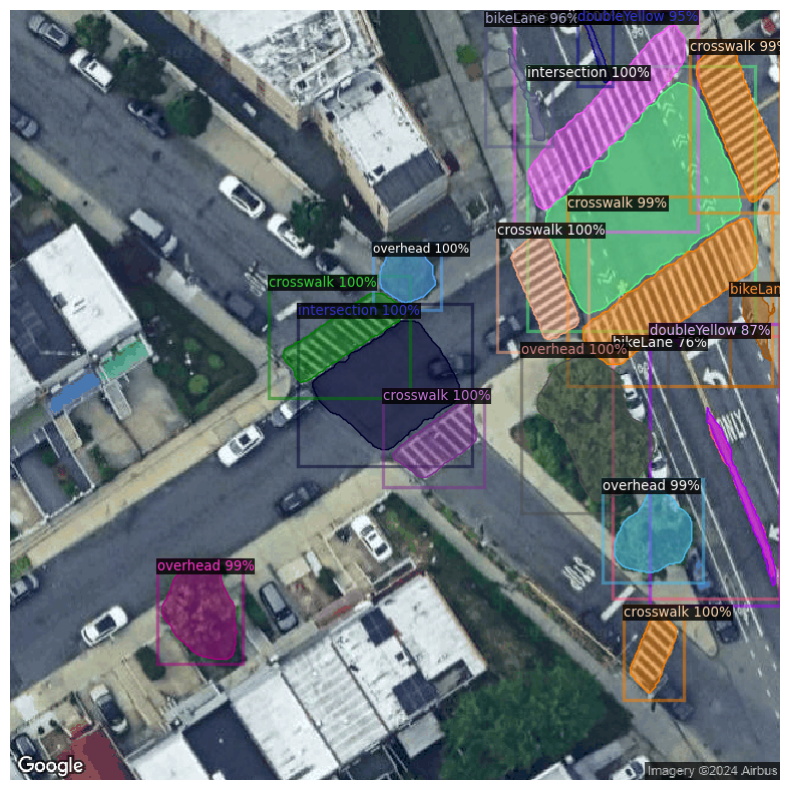

In [71]:
visualize_model_predictions(predictor, image_file_path, metadata)

In [72]:
image_file = '40.688_-73.997562.png'
image_file_path = os.path.join(IMAGES_DIR, image_file)
image = cv2.imread(image_file_path)
predictions = predictor(image)
features = extract_features_2(predictions, class_labels, image_dims, cw_dist_thrshold=10)
display(features)
visualize_annotations_predictions_grid(image_file_path, predictor, metadata, dataset_dicts, plot=True)
visualize_model_predictions(predictor, image_file_path, metadata)

TypeError: Can't convert object to 'str' for 'filename'

In [ ]:
### OLD ###
def extract_features(predictions, class_labels, image_dims, cw_dist_thrshold=10):
    """
    Extract features from predictions, including crosswalk assignments, orientations, and intersection dimensions.
    """
    # Setup
    features = {
        "intersection_count": 0,
        "crosswalk_count": 0,
        "bikeLane_count": 0,
        "parkingLane_count": 0,
        "doubleYellow_count": 0,
        "median_count": 0,
        "overhead_count": 0,
        "overpass_count": 0
    }
    image_center = (image_dims[1] // 2, image_dims[0] // 2)  # (x_center, y_center)

    # Extract masks and classes
    instances = predictions["instances"].to("cpu")
    masks = instances.pred_masks.numpy()
    classes = instances.pred_classes.numpy()

    # Step 1: Extract feature counts
    for i, cls in enumerate(classes):
        # Update feature counts
        features[f'{class_labels[cls]}_count'] += 1

    # Check if there are any intersections
    if features["intersection_count"] == 0:
        return features

    # Step 2: Extract intersection contours and find the main intersection
    intersection_contours = []
    main_intersection = None
    min_distance_to_center = float("inf")
    # Find main intersection instance
    for i, cls in enumerate(classes):
        if class_labels[cls] == "intersection":
            # Extract mask
            mask = masks[i]
            # Find contours
            contours, _ = cv2.findContours(mask.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            if contours:
                contour = max(contours, key=cv2.contourArea)
                intersection_contours.append(contour)
                # Compute distance to image center
                M = cv2.moments(contour)
                cx = int(M["m10"] / M["m00"])
                cy = int(M["m01"] / M["m00"])
                distance_to_center = np.linalg.norm(np.array([cx, cy]) - np.array(image_center))
                # Assign to main intersection if it's the closest to the center
                if distance_to_center < min_distance_to_center:
                    min_distance_to_center = distance_to_center
                    main_intersection = {
                        "mask": mask,
                        "contour": contour,
                        "center": (cx, cy),
                        "box": cv2.boxPoints(cv2.minAreaRect(contour))  # Corners of the bounding box
                    }
    
    # Step 3: Add main intersection dimensions to features dict
    if main_intersection:
        contour = main_intersection["contour"]
        # Ensure contour is a 2D array of (x, y) points
        if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
        # Fit polygon, measure sides and assign directions
        polygon = fit_polygon_delaunay(contour)
        main_intersection["polygon"] = polygon
        side_lengths, _ = measure_intersection_sides(polygon)
        for direction, info in side_lengths.items():
            features[f'int_{direction}_side_length'] = info["length"]

    # Step 4: Identify crosswalks at main intersection and measure dimensions
    crosswalk_counter = 0
    crosswalk_polygons = {}
    crosswalk_lengths = {}
    crosswalk_widths = {}
    for i, cls in enumerate(classes):
        if class_labels[cls] == "crosswalk":
            # Extract mask
            mask = masks[i].astype(np.uint8)
            # Find the largest contour
            contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            contour = max(contours, key=cv2.contourArea)
            # Ensure contour is a 2D array of (x, y) points
            if contour.ndim == 3:
                contour = contour[:, 0, :]  # Convert from (N, 1, 2) to (N, 2)
            # Check if the crosswalk is close to the main intersection
            close_to_intersection = False
            for point in contour:
                point_tuple = (int(point[0]), int(point[1]))
                distance = cv2.pointPolygonTest(main_intersection["contour"], point_tuple, True)
                if abs(distance) <= cw_dist_thrshold:  # Check if within certain number of pixels
                    close_to_intersection = True
                    crosswalk_counter += 1
                    break  # No need to check further
            # If close to intersection, add to main_int_crosswalks
            if close_to_intersection:
                polygon = fit_polygon_delaunay(contour)
                crosswalk_polygons[crosswalk_counter] = polygon
                length, width = measure_crosswalk_dimensions(polygon)
                crosswalk_lengths[crosswalk_counter] = length
                crosswalk_widths[crosswalk_counter] = width
        
        cw_direction = assign_crosswalks_to_directions(main_intersection["polygon"], crosswalk_polygons.values())
        for i, direction in zip(crosswalk_polygons.keys(), cw_direction):
            features[f'cw_{direction}_side_length'] = crosswalk_lengths[i]
            features[f'cw_{direction}_side_width'] = crosswalk_widths[i]

    return features